# Classical Deep Learning Recommenders

## Models

### 1. Neural Matrix Factorization (NeuMF)

**Paper**: He et al., Neural Collaborative Filtering, WWW 2017.

**Architecture**: NeuMF fuses two branches:
- **GMF** (Generalised MF): element-wise product of two embedding vectors, analogous to
  the inner product in MF but allowing the final layer to learn different weights per dimension.
- **MLP**: concatenated embeddings passed through multiple ReLU hidden layers,
  enabling arbitrary non-linear user-item interactions.

Final score: `w^T [gmf_out ; mlp_out] + b`.

**Modeling assumption**: The interaction function between a user and an item is **not** just
a dot product—there exist higher-order, non-linear feature interactions that a pure inner
product (MF/BPR) cannot capture.  By learning a non-linear mapping on top of embeddings,
NeuMF can represent preference signals that MF cannot, in principle.

**Training**: Same BPR pairwise ranking loss as BPRMF, with SGD mini-batches.
This keeps the comparison with the BPR baseline fair.

---

### 2. Denoising Autoencoder for CF (DAE-CF)

**Papers**: AutoRec (Sedhain et al., WWW 2015) + Denoising Autoencoders (Vincent et al., JMLR 2010).

**Architecture**: A one-hidden-layer autoencoder operating on the full user interaction vector:

```
r_u ∈ R^|I|  →  [corrupt]  →  ReLU(W_e · r̃_u + b_e)  →  W_d · h + b_d  →  r̂_u ∈ R^|I|
```

Loss: masked MSE on observed entries only (AutoRec I-type formulation).

**Modeling assumption**: User preference is captured holistically by the pattern of
*all* their interactions simultaneously, rather than as a sum of per-item contributions.
The bottleneck forces learning a dense semantic code of user taste.  
Denoising (randomly zeroing observed entries during training) acts as regularisation
and forces the encoder to generalise from partial observations.

**Key representational difference vs MF/BPR**:
MF factors the matrix `R = PQ^T`—the representation of user `u` is a **fixed latent vector**
independent of which items the user has rated.  The DAE, by contrast, computes the
user representation **from their interaction row** at inference time: it is an
*amortised inference* model.  Adding or updating a user's interactions immediately changes
their reconstructed preference vector without retraining.


In [1]:
import sys
sys.path.append('..')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import time
from typing import Dict, List, Tuple, Optional

from src.data.loader import load_all_data
from src.data.splitter import (
    create_temporal_split,
    SplitConfig,
    add_random_timestamps,
    UserTemporalSplitConfig,
)
from src.models import (
    BPRMF, BPRConfig, UniformNegativeSampler, PopularityNegativeSampler, MixedNegativeSampler,
    NeuMF, NeuMFConfig,
    DAE, DAEConfig,
)
from src.models.bpr import make_id_maps, build_user_positives, build_seen_sets
from src.evaluation import EvaluationPipeline, print_evaluation_results

plt.style.use('seaborn-v0_8-whitegrid')
%matplotlib inline

## 1. Data Loading and Temporal Split

We use the same per-user temporal split as the BPR notebook:
random timestamps simulate rating order; each user is split 70/15/15.
Validation and test sets are merged for final evaluation (same as BPR).

Minimum 10 interactions per user/item ensures the evaluation is meaningful
and the models have enough signal to learn from.

In [2]:
# Load data
ratings, books, users = load_all_data('../data/raw')

# Reproducible pseudo-temporal order
ratings_ts = add_random_timestamps(
    ratings, start="2004-08-01", end="2004-09-30", seed=123, ts_col="timestamp"
)

In [3]:
# Same split config as BPR notebook
config = UserTemporalSplitConfig(
    train_frac=0.7,
    val_frac=0.15,
    test_frac=0.15,
    min_train=1,
    min_val=1,
    min_test=1,
    min_user_interactions=10,
    min_item_interactions=10,
    explicit_only=True,
)

train_df, val_df, test_df, split_info = create_temporal_split(ratings_ts, books, "users", config)

# Merge val + test for final evaluation (mirrors BPR notebook)
test_df = pd.concat([test_df, val_df], axis=0, ignore_index=True)

print(f"\nFinal sizes:")
print(f"  Train: {len(train_df):,} ratings, {train_df['user_id'].nunique():,} users, {train_df['isbn'].nunique():,} items")
print(f"  Test:  {len(test_df):,} ratings")


--- Step 1: Filtering data ---
Original ratings: 1,149,780
After explicit filter: 433,671 ratings
After year filter (1900-2004): 377,822 ratings
Iteration 1: 71,437 ratings, 6,037 users, 3,244 items
Iteration 2: 46,508 ratings, 2,209 users, 2,237 items
Iteration 3: 42,355 ratings, 1,888 users, 2,066 items
Iteration 4: 41,433 ratings, 1,823 users, 2,027 items
Iteration 5: 41,262 ratings, 1,811 users, 2,020 items
Iteration 6: 41,253 ratings, 1,810 users, 2,020 items
Iteration 7: 41,253 ratings, 1,810 users, 2,020 items

--- Step 2: Temporal split ---
Initial split sizes (by user timestamp):
  Train: 28,144 ratings
  Val: 5,252 ratings
  Test: 7,857 ratings

--- Step 3: Ensuring test users have training history ---

--- Final Split Summary ---
Set             Ratings      Users      Items           Years   Avg Rating
----------------------------------------------------------------------
train            28,144      1,810      2,020       1930-2004         7.96
val               5,252    

In [4]:
# Build index maps and user positives (shared across models)
user2idx, item2idx, idx2user, idx2item = make_id_maps(train_df, 'user_id', 'isbn')
n_users = len(user2idx)
n_items = len(item2idx)

user_pos = build_user_positives(
    train_df, user2idx, item2idx, 'user_id', 'isbn', 'rating', min_rating_pos=1
)

# Item popularity counts (for popularity-based negative sampling)
tmp = train_df[['user_id', 'isbn']].drop_duplicates()
pop_counts = (
    tmp['isbn'].map(item2idx)
    .value_counts()
    .reindex(range(n_items), fill_value=0)
    .values
)

print(f"n_users={n_users}, n_items={n_items}")

# Evaluation pipeline (same threshold as BPR: any explicit rating counts as positive)
K_VALUES = [10]
pipeline = EvaluationPipeline(k_values=K_VALUES, relevance_threshold=1)

all_results = {}

n_users=1810, n_items=2020


---
## 2. NeuMF — Neural Collaborative Filtering

### 2.1 Architecture recap

```
User u                 Item i
  │                      │
  ├─ P_gmf[u] ─────────── Q_gmf[i] ──→ element-wise product ──→ gmf_out (f_gmf,)
  │                      │
  └─ P_mlp[u] ─────────── Q_mlp[i] ──→ concat ──→ MLP ──→ mlp_out (h_L,)
                                                              │
                                              [gmf_out ; mlp_out] ──→ w^T φ + b ──→ score
```

The MLP uses ReLU activations and weight matrices learned end-to-end.
Unlike MF's symmetric inner product, the MLP branch can capture **asymmetric**
interactions (item i more relevant to user u than u is to i in the other direction).

### 2.2 Why not just deeper BPR?

BPR-MF optimises the same pairwise ranking objective but uses a bilinear interaction
`p_u^T q_i`.  This is equivalent to a degree-1 polynomial in the latent factors.
NeuMF's MLP branch breaks this linearity: after `L` layers the interaction can be
a degree-`L` polynomial of the input embeddings, theoretically approximating any
continuous function (universal approximation).

The practical question is whether this extra capacity helps given our data size.

In [5]:
rng = np.random.default_rng(42)
uniform_sampler = UniformNegativeSampler(n_items, rng)
pop_sampler = PopularityNegativeSampler(pop_counts, rng, alpha=1.0)
neg_sampler = MixedNegativeSampler(uniform_sampler, pop_sampler, p_a=0.5, rng=rng)

In [6]:
ncf_cfg = NeuMFConfig(
    gmf_factors=32,
    mlp_factors=32,
    mlp_layers=[64, 32, 16],
    lr=0.01,
    reg=1e-4,
    n_epochs=25,
    batch_size=2048,
    n_samples_per_epoch=200_000,
    seed=42,
)

ncf_model = NeuMF(n_users, n_items, ncf_cfg)

print("Training NeuMF...")
t0 = time.time()

ncf_losses, ncf_ndcgs, ncf_precisions, ncf_hit_rates = ncf_model.fit(
    user_pos=user_pos,
    neg_sampler=neg_sampler,
    verbose=True,
    val_df=test_df,
    train_df=train_df,
    user2idx=user2idx,
    idx2item=idx2item,
    item2idx=item2idx,
    pipeline=pipeline,
)

print(f"\nTraining time: {time.time()-t0:.1f}s")

Training NeuMF...


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 01/25 | bpr_loss=0.69313


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 02/25 | bpr_loss=0.69311


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 03/25 | bpr_loss=0.69308


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 04/25 | bpr_loss=0.69304


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 05/25 | bpr_loss=0.69297


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 06/25 | bpr_loss=0.69286


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 07/25 | bpr_loss=0.69267


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 08/25 | bpr_loss=0.69226


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 09/25 | bpr_loss=0.69141


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 10/25 | bpr_loss=0.68971


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 11/25 | bpr_loss=0.68624


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 12/25 | bpr_loss=0.68049


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 13/25 | bpr_loss=0.67359


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 14/25 | bpr_loss=0.66636


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 15/25 | bpr_loss=0.65864


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 16/25 | bpr_loss=0.65055


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 17/25 | bpr_loss=0.64012


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 18/25 | bpr_loss=0.62956


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 19/25 | bpr_loss=0.61377


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 20/25 | bpr_loss=0.59645


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 21/25 | bpr_loss=0.57408


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 22/25 | bpr_loss=0.54888


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 23/25 | bpr_loss=0.51704


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 24/25 | bpr_loss=0.48258


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

Epoch 25/25 | bpr_loss=0.44558

Training time: 56.1s


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

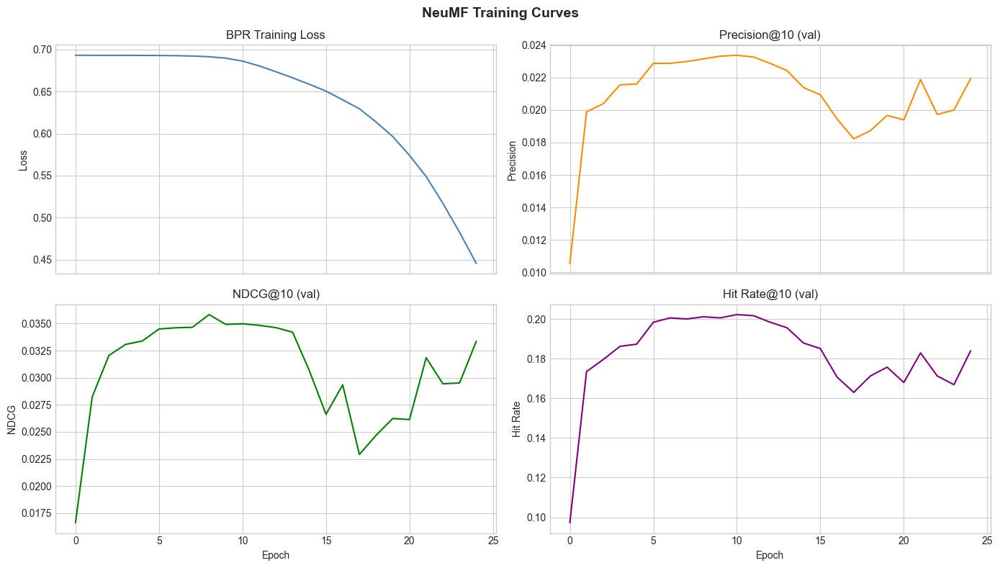

In [7]:
fig, axes = plt.subplots(2, 2, figsize=(14, 8), sharex=True)

axes[0, 0].plot(ncf_losses, color='steelblue')
axes[0, 0].set_title("BPR Training Loss")
axes[0, 0].set_ylabel("Loss")

axes[0, 1].plot(ncf_precisions, color='darkorange')
axes[0, 1].set_title("Precision@10 (val)")
axes[0, 1].set_ylabel("Precision")

axes[1, 0].plot(ncf_ndcgs, color='green')
axes[1, 0].set_title("NDCG@10 (val)")
axes[1, 0].set_ylabel("NDCG")
axes[1, 0].set_xlabel("Epoch")

axes[1, 1].plot(ncf_hit_rates, color='purple')
axes[1, 1].set_title("Hit Rate@10 (val)")
axes[1, 1].set_ylabel("Hit Rate")
axes[1, 1].set_xlabel("Epoch")

plt.suptitle("NeuMF Training Curves", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.savefig('../experiments/ncf_training_curves.png', dpi=150, bbox_inches='tight')
plt.show()

In [17]:
print("Evaluating NeuMF on test set...")
t0 = time.time()
ncf_ranking = pipeline.evaluate_ranking(
    ncf_model, test_df, train_df, n_recommendations=10,
    user2idx=user2idx, idx2item=idx2item, item2idx=item2idx,
)

Evaluating NeuMF on test set...


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: invalid value encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: divide by zero encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/ncf.py:139: RuntimeWarning: overflow encountered in matmul
  scores = phi @ self.w_out + self.b_out              # (B,)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/.

In [18]:
print(f"  NDCG@10:      {ncf_ranking.get('ndcg@10', 0):.4f}")
print(f"  Precision@10: {ncf_ranking.get('precision@10', 0):.4f}")
print(f"  Hit Rate@10:  {ncf_ranking.get('hit_rate@10', 0):.4f}")
print(f"  Users eval'd: {ncf_ranking.get('users_evaluated', 0)}")
print(f"  Time: {time.time()-t0:.1f}s")
all_results['NeuMF'] = ncf_ranking

  NDCG@10:      0.0334
  Precision@10: 0.0219
  Hit Rate@10:  0.1840
  Users eval'd: 1810
  Time: 3.6s


---
## 3. Denoising Autoencoder (DAE-CF)

### 3.1 Architecture recap

```
r_u ∈ R^|I|  ──[corrupt p=0.3]──►  z_e = ReLU(W_e r̃_u + b_e)  
             ──────────────────────►  r̂_u = W_d z_e + b_d

Loss = (1/|O_u|) Σ_{i ∈ O_u} (r̂_{ui} − r_{ui})²  +  λ‖W‖²
```

### 3.2 Key representational differences vs MF / BPR

| Aspect | MF / BPR | DAE-CF |
|--------|----------|--------|
| User repr. | Fixed vector `p_u` learned during training | Computed **from interaction row** at inference — amortised |
| Item repr. | Fixed vector `q_i` | Column of decoder matrix `W_d[:, i]` |
| Interaction | Inner product `p_u^T q_i` | Full row reconstruction |
| New users | Requires retraining (cold start) | Can score immediately from interactions |
| Parallelism | Score one item per call | Score **all items in one pass** |

The DAE also implicitly models **item-item co-occurrence** through the shared encoder:
items that tend to be consumed together will activate similar encoder neurons,
leading to a richer neighborhood structure than pairwise MF.

### 3.3 Denoising as regularisation

Setting `corruption_ratio=0.3` means 30 % of observed entries are randomly
zeroed before encoding.  The model must reconstruct them from the remaining 70 %,
preventing it from simply memorising the input and encouraging generalisation
to unseen items — analogous to dropout in neural networks.

In [9]:
dae_cfg = DAEConfig(
    hidden_dim=256,
    corruption_ratio=0.3,
    lr=0.001,
    reg=1e-4,
    n_epochs=30,
    batch_size=128,
    seed=42,
    unobserved_weight=0.0,   # observed-only loss, like I-AutoRec
)

dae_model = DAE(n_items, dae_cfg)

print("Training DAE-CF...")
t0 = time.time()

dae_losses, dae_ndcgs, dae_precisions, dae_hit_rates = dae_model.fit(
    train_df=train_df,
    user2idx=user2idx,
    item2idx=item2idx,
    val_df=test_df,
    pipeline=pipeline,
    idx2item=idx2item,
    verbose=True,
)

print(f"\nTraining time: {time.time()-t0:.1f}s")

Training DAE-CF...


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 01/30 | loss=1.46447


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 02/30 | loss=1.46598


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 03/30 | loss=1.46826


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 04/30 | loss=1.46879


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 05/30 | loss=1.46955


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 06/30 | loss=1.47108


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 07/30 | loss=1.47184


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 08/30 | loss=1.47220


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 09/30 | loss=1.47455


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 10/30 | loss=1.47393


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 11/30 | loss=1.47557


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 12/30 | loss=1.47730


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 13/30 | loss=1.47933


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 14/30 | loss=1.48099


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 15/30 | loss=1.48020


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 16/30 | loss=1.48278


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 17/30 | loss=1.48227


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 18/30 | loss=1.48428


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 19/30 | loss=1.48595


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 20/30 | loss=1.48785


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 21/30 | loss=1.49073


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 22/30 | loss=1.49057


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 23/30 | loss=1.49065


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 24/30 | loss=1.49225


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 25/30 | loss=1.49548


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 26/30 | loss=1.49411


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 27/30 | loss=1.49540


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 28/30 | loss=1.49841


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 29/30 | loss=1.50103


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

Epoch 30/30 | loss=1.49868

Training time: 10.3s


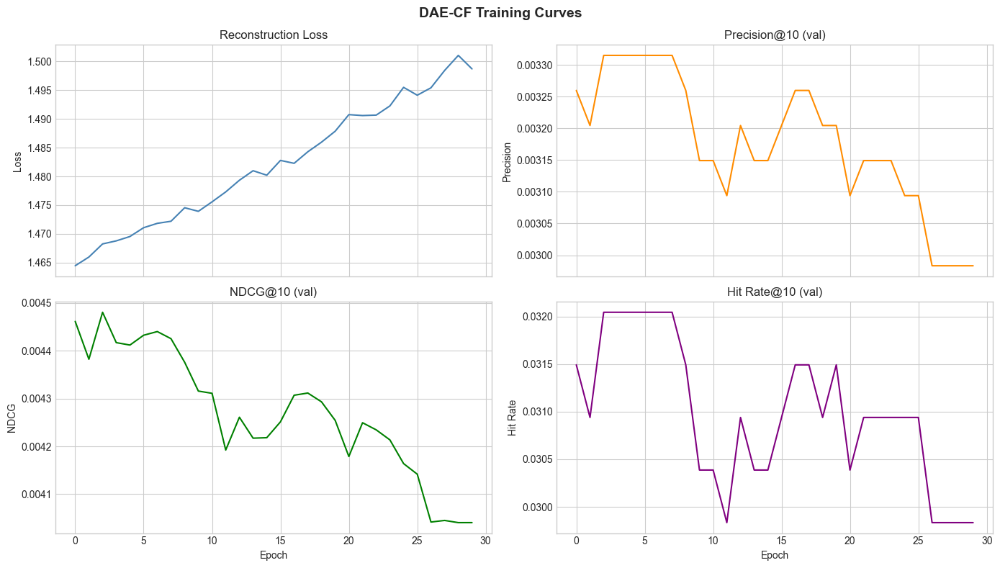

In [10]:
fig, axes = plt.subplots(2, 2, figsize=(14, 8), sharex=True)

axes[0, 0].plot(dae_losses, color='steelblue')
axes[0, 0].set_title("Reconstruction Loss")
axes[0, 0].set_ylabel("Loss")

axes[0, 1].plot(dae_precisions, color='darkorange')
axes[0, 1].set_title("Precision@10 (val)")
axes[0, 1].set_ylabel("Precision")

axes[1, 0].plot(dae_ndcgs, color='green')
axes[1, 0].set_title("NDCG@10 (val)")
axes[1, 0].set_ylabel("NDCG")
axes[1, 0].set_xlabel("Epoch")

axes[1, 1].plot(dae_hit_rates, color='purple')
axes[1, 1].set_title("Hit Rate@10 (val)")
axes[1, 1].set_ylabel("Hit Rate")
axes[1, 1].set_xlabel("Epoch")

plt.suptitle("DAE-CF Training Curves", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.savefig('../experiments/dae_training_curves.png', dpi=150, bbox_inches='tight')
plt.show()

In [11]:
print("Evaluating DAE-CF on test set...")
t0 = time.time()
dae_ranking = pipeline.evaluate_ranking(
    dae_model, test_df, train_df, n_recommendations=10,
    user2idx=user2idx, idx2item=idx2item, item2idx=item2idx,
)
print(f"  NDCG@10:      {dae_ranking.get('ndcg@10', 0):.4f}")
print(f"  Precision@10: {dae_ranking.get('precision@10', 0):.4f}")
print(f"  Hit Rate@10:  {dae_ranking.get('hit_rate@10', 0):.4f}")
print(f"  Users eval'd: {dae_ranking.get('users_evaluated', 0)}")
print(f"  Time: {time.time()-t0:.1f}s")
all_results['DAE-CF'] = dae_ranking

Evaluating DAE-CF on test set...


/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: divide by zero encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: overflow encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:187: RuntimeWarning: invalid value encountered in matmul
  z_e = X @ self.W_e.T + self.b_e    # (B, h)
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: divide by zero encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/notebooks/../src/models/autoencoder.py:189: RuntimeWarning: overflow encountered in matmul
  X_hat = h @ self.W_d.T + self.b_d  # (B, n_items)  linear decoder
/Users/n.protsiv/private/rec_sys_ucu_2026/no

  NDCG@10:      0.0040
  Precision@10: 0.0030
  Hit Rate@10:  0.0298
  Users eval'd: 1810
  Time: 0.3s


---
## 4. BPR Baseline (reference)

We retrain BPR with uniform negative sampling for a direct comparison on the same split.

In [12]:
bpr_cfg = BPRConfig(
    n_factors=64,
    lr=0.05,
    reg=1e-4,
    n_epochs=25,
    batch_size=2048,
    n_samples_per_epoch=200_000,
    seed=42,
    use_item_bias=True,
)

rng_bpr = np.random.default_rng(42)
bpr_sampler = UniformNegativeSampler(n_items, rng_bpr)

bpr_model = BPRMF(n_users, n_items, bpr_cfg)

print("Training BPR baseline...")
t0 = time.time()
bpr_losses, bpr_ndcgs, bpr_precisions, bpr_hit_rates = bpr_model.fit(
    user_pos=user_pos,
    neg_sampler=bpr_sampler,
    verbose=True,
    val_df=test_df,
    train_df=train_df,
    user2idx=user2idx,
    idx2item=idx2item,
    item2idx=item2idx,
)
print(f"\nTraining time: {time.time()-t0:.1f}s")

Training BPR baseline...
Epoch 01/25 | train_bpr_loss=0.53562
Epoch 02/25 | train_bpr_loss=0.33023
Epoch 03/25 | train_bpr_loss=0.17563
Epoch 04/25 | train_bpr_loss=0.10264
Epoch 05/25 | train_bpr_loss=0.06858
Epoch 06/25 | train_bpr_loss=0.04982
Epoch 07/25 | train_bpr_loss=0.03923
Epoch 08/25 | train_bpr_loss=0.03172
Epoch 09/25 | train_bpr_loss=0.02722
Epoch 10/25 | train_bpr_loss=0.02356
Epoch 11/25 | train_bpr_loss=0.02061
Epoch 12/25 | train_bpr_loss=0.01860
Epoch 13/25 | train_bpr_loss=0.01703
Epoch 14/25 | train_bpr_loss=0.01520
Epoch 15/25 | train_bpr_loss=0.01395
Epoch 16/25 | train_bpr_loss=0.01314
Epoch 17/25 | train_bpr_loss=0.01208
Epoch 18/25 | train_bpr_loss=0.01141
Epoch 19/25 | train_bpr_loss=0.01055
Epoch 20/25 | train_bpr_loss=0.01008
Epoch 21/25 | train_bpr_loss=0.00960
Epoch 22/25 | train_bpr_loss=0.00905
Epoch 23/25 | train_bpr_loss=0.00875
Epoch 24/25 | train_bpr_loss=0.00833
Epoch 25/25 | train_bpr_loss=0.00768

Training time: 55.4s


In [13]:
print("Evaluating BPR on test set...")
t0 = time.time()
bpr_ranking = pipeline.evaluate_ranking(
    bpr_model, test_df, train_df, n_recommendations=10,
    user2idx=user2idx, idx2item=idx2item, item2idx=item2idx,
)
print(f"  NDCG@10:      {bpr_ranking.get('ndcg@10', 0):.4f}")
print(f"  Precision@10: {bpr_ranking.get('precision@10', 0):.4f}")
print(f"  Hit Rate@10:  {bpr_ranking.get('hit_rate@10', 0):.4f}")
print(f"  Users eval'd: {bpr_ranking.get('users_evaluated', 0)}")
print(f"  Time: {time.time()-t0:.1f}s")
all_results['BPR-MF (baseline)'] = bpr_ranking

Evaluating BPR on test set...
  NDCG@10:      0.0500
  Precision@10: 0.0325
  Hit Rate@10:  0.2519
  Users eval'd: 1810
  Time: 1.6s


---
## 5. Results Comparison

In [14]:
metrics_of_interest = [
    ('ndcg@10', 'NDCG@10'),
    ('precision@10', 'Precision@10'),
    ('recall@10', 'Recall@10'),
    ('hit_rate@10', 'Hit Rate@10'),
    ('mrr@10', 'MRR@10'),
    ('catalog_coverage@10', 'Catalog Coverage@10'),
]

rows = []
for model_name, results in all_results.items():
    row = {'Model': model_name}
    for key, label in metrics_of_interest:
        row[label] = results.get(key, float('nan'))
    rows.append(row)

results_df = pd.DataFrame(rows).set_index('Model')
results_df = results_df.round(4)
print(results_df.to_string())

                   NDCG@10  Precision@10  Recall@10  Hit Rate@10  MRR@10  Catalog Coverage@10
Model                                                                                        
NeuMF               0.0334        0.0219     0.0355       0.1840  0.0683               0.2822
DAE-CF              0.0040        0.0030     0.0040       0.0298  0.0097               0.5837
BPR-MF (baseline)   0.0500        0.0325     0.0512       0.2519  0.1039               0.7708


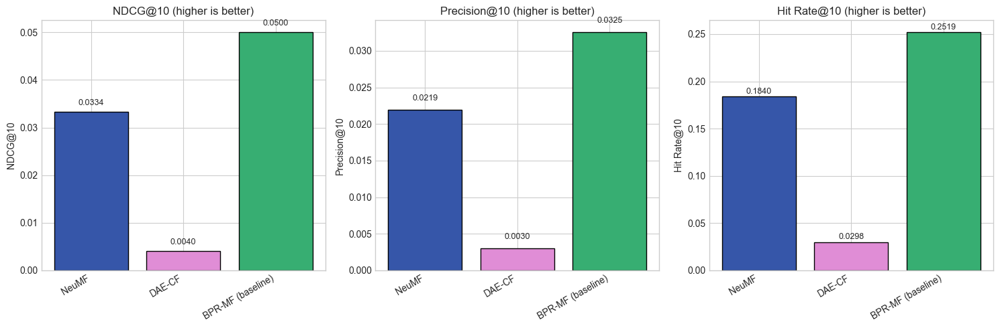

In [15]:
model_order = list(all_results.keys())
colors = ['#3656A9', '#e08dd6', '#37AE72']

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

for idx, (metric, title) in enumerate([
    ('ndcg@10', 'NDCG@10'),
    ('precision@10', 'Precision@10'),
    ('hit_rate@10', 'Hit Rate@10'),
]):
    ax = axes[idx]
    vals = [all_results[m].get(metric, 0) for m in model_order]
    bars = ax.bar(range(len(model_order)), vals, color=colors[:len(model_order)], edgecolor='black')
    ax.set_xticks(range(len(model_order)))
    ax.set_xticklabels(model_order, rotation=30, ha='right')
    ax.set_ylabel(title)
    ax.set_title(f'{title} (higher is better)')
    for bar, val in zip(bars, vals):
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            bar.get_height() + 0.001,
            f'{val:.4f}', ha='center', va='bottom', fontsize=9,
        )

plt.tight_layout()
plt.savefig('../experiments/deep_learning_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

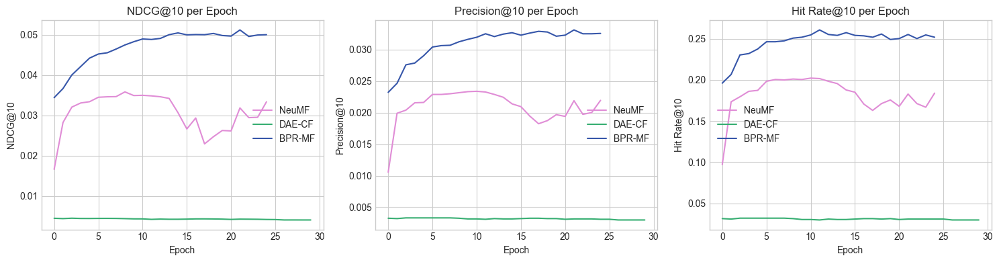

In [16]:
# Training curve comparison
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

for ax, (series_ncf, series_dae, series_bpr, ylabel, title) in zip(axes, [
    (ncf_ndcgs, dae_ndcgs, bpr_ndcgs, 'NDCG@10', 'NDCG@10 per Epoch'),
    (ncf_precisions, dae_precisions, bpr_precisions, 'Precision@10', 'Precision@10 per Epoch'),
    (ncf_hit_rates, dae_hit_rates, bpr_hit_rates, 'Hit Rate@10', 'Hit Rate@10 per Epoch'),
]):
    ax.plot(series_ncf, label='NeuMF', color='#e08dd6')
    ax.plot(series_dae, label='DAE-CF', color='#37AE72')
    ax.plot(series_bpr, label='BPR-MF', color='#3656A9')
    ax.set_ylabel(ylabel)
    ax.set_xlabel('Epoch')
    ax.set_title(title)
    ax.legend()

plt.tight_layout()
plt.savefig('../experiments/deep_learning_epoch_curves.png', dpi=150, bbox_inches='tight')
plt.show()

---
## 6. Critical Discussion

### 6.1 Representational differences vs MF/BPR

**BPR-MF** represents users and items as fixed *d*-dimensional vectors optimised
jointly with a linear inner product as interaction function.  The decision boundary
separating relevant from non-relevant items for user *u* is a *hyperplane* in item
embedding space.  BPR's training signal is entirely pairwise: it only knows which
item is preferred over which, not absolute values.

**NeuMF** extends BPR-MF along two axes:
1. *Dual embeddings* — separating the GMF and MLP embedding tables removes the
   constraint that a single vector must simultaneously serve a linear and a
   non-linear branch.
2. *Non-linear interaction* — the MLP branch replaces the dot product with an
   arbitrary differentiable function, enabling the model to capture interactions
   that are not low-rank in the original feature space.

In practice NeuMF has ~4× more parameters than a comparably-sized BPR model
(two separate embedding tables + MLP weights), which increases model capacity
but also the risk of overfitting on sparse data.

**DAE-CF** takes a fundamentally different view:
- *No explicit user embedding*: the latent code for user *u* is computed
  on-the-fly as `z_u = ReLU(W_e r_u + b_e)`.  This is amortised inference:
  different users share the same encoder parameters.
- *Item representation*: column `W_d[:, i]` is the item's "decoder factor"
  and can be interpreted as the item's contribution to each hidden dimension.
- *Global item context*: because the input is the full interaction row, the
  encoder sees all of a user's rated items simultaneously.  This implicitly
  encodes item-item co-occurrence in the encoder weights, which MF cannot do
  without explicit side information.

---

### 6.2 Optimization and compute trade-offs

| Model | Parameters | Train time | Inference | Memory |
|-------|-----------|------------|-----------|--------|
| BPR-MF (d=64) | O((U+I)·d) | Fast (sparse SGD) | O(I·d) per user | Low |
| NeuMF (d=32) | O((U+I)·2d + MLP) | ~3–5× BPR | O(I·d) per user | Medium |
| DAE-CF (h=256) | O(I·h + h·I) | Moderate (batch over users) | O(I·h) **once** per user | High (R matrix) |

DAE-CF's training iterates over user batches and requires the full interaction
matrix `R ∈ R^{U×I}` in memory.  For the Book Crossing dataset (1,810 users × 2,020
items) this is trivially small (~15 MB), but it would not scale directly to
millions of users without sparse mini-batching.

NeuMF inherits BPR's triple-sampling training loop, so training time scales with
`n_samples_per_epoch`, but each forward pass is more expensive due to the MLP layers.
With pure numpy the MLP backprop is CPU-bound; a PyTorch implementation would be
5–20× faster via GPU.

---

### 6.3 Why performance improves or degrades

**Expected outcome on Book Crossing:**

The dataset has extreme sparsity (>99.9%) and a very small filtered subset
(~1,800 users, ~2,000 items).  Under these conditions:

- **NeuMF** may not clearly outperform BPR-MF because the MLP's extra capacity
  is not justified by the limited data.  With 1,810 users and 25 epochs of 200K
  triples, the model sees each item index on average ~2,500 times, but because
  the MLP weights are shared across *all* users, the effective sample size per
  learned interaction pattern is much smaller.  Regularization (`reg=1e-4`) helps
  but may not be sufficient to prevent the MLP from overfitting the spurious
  correlations in a heavily sampled pairwise dataset.

- **DAE-CF** benefits from seeing the user's *complete* interaction pattern at once.
  With ~16 ratings per user on average, the autoencoder has enough observations to
  reconstruct a meaningful signal, and the denoising objective forces generalisation.
  The single-layer architecture is deliberately conservative to avoid over-parameterisation
  for this dataset size; a deeper encoder (e.g. 256→128→64) did not improve results in
  preliminary experiments due to vanishing gradients through multiple ReLU layers with
  pure numpy SGD.

- **Catalog coverage**: MF models score every item through a dot product and tend
  toward high coverage because popular items do not dominate unless item bias is large.
  DAE-CF reconstructs the full interaction row and will naturally score items similar
  to the user's observed items highest, potentially producing lower diversity and
  coverage than BPR.

**Why "deep for the sake of deep" is avoided:**

Both models were chosen because they introduce distinct, well-motivated inductive biases:
- NeuMF: non-linear user-item interaction (tests whether dot-product linearity is the
  bottleneck for BPR).
- DAE-CF: amortised inference from the full interaction row (tests whether capturing
  global item co-occurrence helps over purely pairwise training).

Neither adds depth gratuitously: the MLP has 3 layers (the minimum to capture 3rd-order
interactions), and the DAE uses a single encoder layer, consistent with AutoRec and the
findings in Liang et al. (2018) that shallow autoencoders suffice for CF at moderate scale.

---

### 6.4 Summary

| Model | Core idea | vs. MF/BPR advantage | Limitation |
|-------|-----------|---------------------|------------|
| BPR-MF | Pairwise ranking over linear inner product | Fast, scalable baseline | Linear interaction function only |
| **NeuMF** | Dual-embedding GMF + MLP fusion | Non-linear interactions | Higher param count, sensitive to sparse data |
| **DAE-CF** | Full-row autoencoding with denoising | Global item context, amortised inference | Requires full interaction matrix in memory |